# Libraries

In [2]:
import torch
import os
import glob
from IPython.display import Image, display

%cd yolov5
print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

F:\Yolov5_Fire_Detection\yolov5
Setup complete. Using torch 1.8.0+cu111 (GeForce RTX 3070)


# Train YOLOv5 model

In [3]:
!python train.py --img 640 --batch 16 --epochs 3 --data ../fire_config.yaml --weights yolov5s.pt --workers 1

Weights & Biases: run 'pip install wandb' to automatically track and visualize YOLOv5  runs (RECOMMENDED)
module 'signal' has no attribute 'SIGALRM'


E:\Programs\Anaconda3\lib\site-packages\pandas\compat\_optional.py:138: UserWarning: Pandas requires version '2.7.0' or newer of 'numexpr' (version '2.6.9' currently installed).
  warnings.warn(msg, UserWarning)
E:\Programs\Anaconda3\lib\site-packages\statsmodels\tools\_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm
train: weights=yolov5s.pt, cfg=, data=../fire_config.yaml, hyp=data\hyps\hyp.scratch-low.yaml, epochs=3, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=1, project=runs\train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=la

Traceback (most recent call last):
  File "<string>", line 1, in <module>
  File "E:\Programs\Anaconda3\lib\multiprocessing\spawn.py", line 105, in spawn_main
    exitcode = _main(fd)
  File "E:\Programs\Anaconda3\lib\multiprocessing\spawn.py", line 114, in _main
    prepare(preparation_data)
  File "E:\Programs\Anaconda3\lib\multiprocessing\spawn.py", line 225, in prepare
    _fixup_main_from_path(data['init_main_from_path'])
  File "E:\Programs\Anaconda3\lib\multiprocessing\spawn.py", line 277, in _fixup_main_from_path
    run_name="__mp_main__")
  File "E:\Programs\Anaconda3\lib\runpy.py", line 263, in run_path
    pkg_name=pkg_name, script_name=fname)
  File "E:\Programs\Anaconda3\lib\runpy.py", line 96, in _run_module_code
    mod_name, mod_spec, pkg_name, script_name)
  File "E:\Programs\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "F:\Yolov5_Fire_Detection\yolov5\train.py", line 26, in <module>
    import torch
  File "E:\Programs\Anaconda3\l

# Evaluate Custom YOLOv5 Detector Performance
Training losses and performance metrics are saved to Tensorboard and also to a logfile.

In [32]:
from utils.plots import plot_results
plot_results('runs/train/exp/results.csv')

### Prediction on Images

In [11]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 640 --conf 0.25 --source ../datasets/fire/val/images/

E:\Programs\Anaconda3\lib\site-packages\pandas\compat\_optional.py:138: UserWarning: Pandas requires version '2.7.0' or newer of 'numexpr' (version '2.6.9' currently installed).
  warnings.warn(msg, UserWarning)
E:\Programs\Anaconda3\lib\site-packages\statsmodels\tools\_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm
detect: weights=['runs/train/exp/weights/best.pt'], source=../datasets/fire/val/images/, data=data\coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs\detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
requirements: requests>=2.23.0 not found and is required by YOLOv5, attempting auto-update...
ER

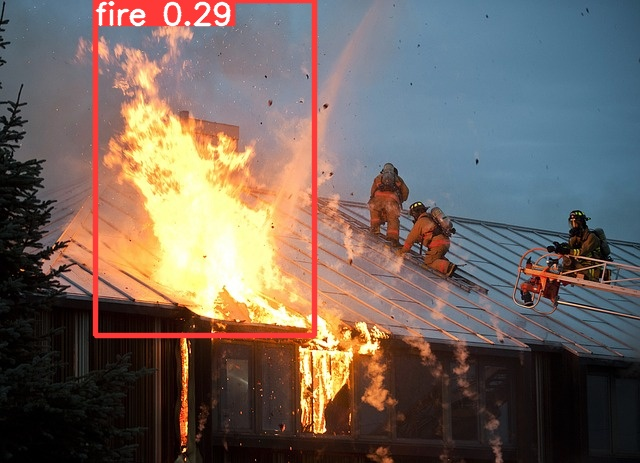

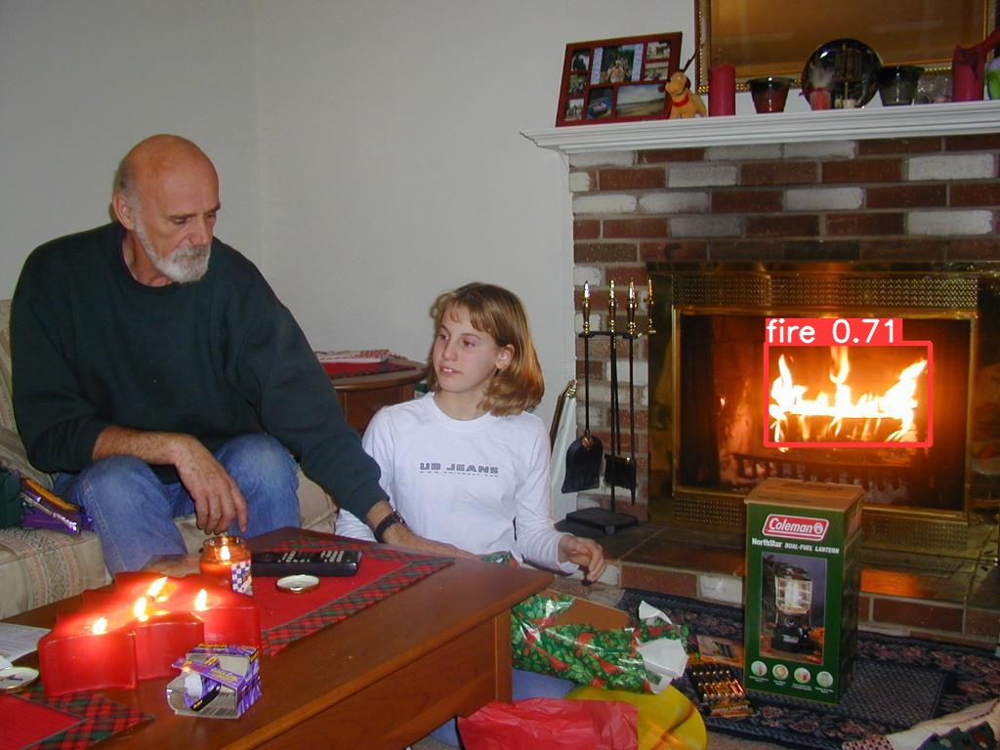

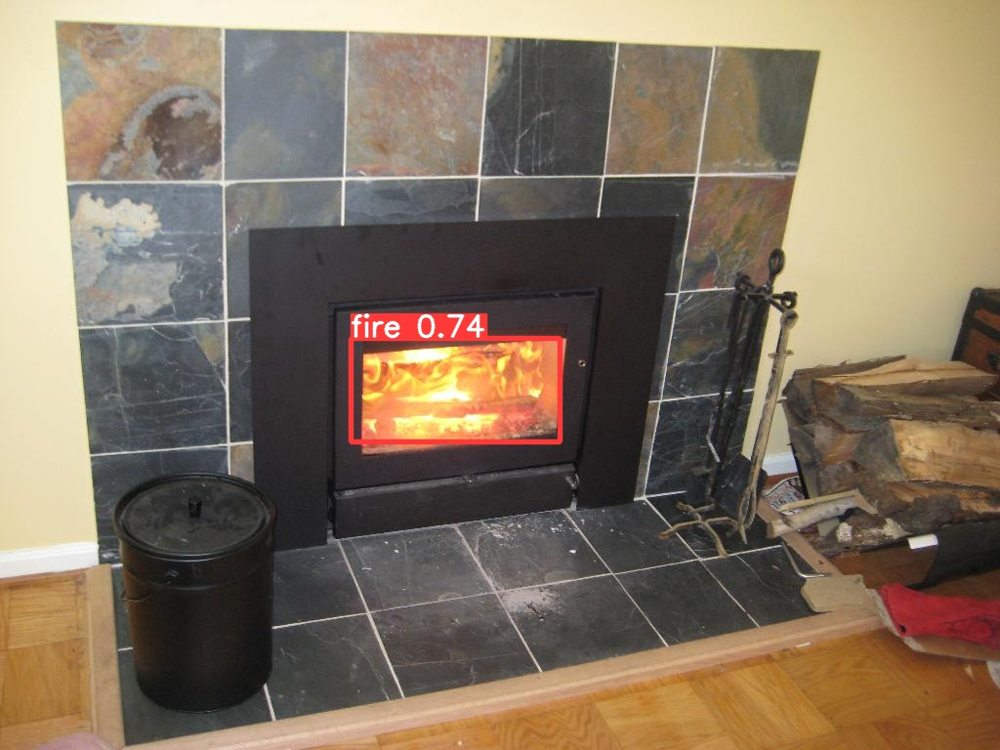

In [12]:
#display inference on some test images
images = glob.glob('runs/detect/exp/*.jpg')

for imageName in images[:3]: #assuming JPG
    display(Image(filename=imageName, width=400))

### Prediction on Video 

In [15]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 640 --conf 0.25 --source ../input.mp4

E:\Programs\Anaconda3\lib\site-packages\pandas\compat\_optional.py:138: UserWarning: Pandas requires version '2.7.0' or newer of 'numexpr' (version '2.6.9' currently installed).
  warnings.warn(msg, UserWarning)
E:\Programs\Anaconda3\lib\site-packages\statsmodels\tools\_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm
detect: weights=['runs/train/exp/weights/best.pt'], source=../input.mp4, data=data\coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs\detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
requirements: requests>=2.23.0 not found and is required by YOLOv5, attempting auto-update...
ERROR: Invalid req

Results saved to runs\detect\exp2


In [22]:
import cv2
vidcap = cv2.VideoCapture('runs/detect/exp2/input.mp4')
success,image = vidcap.read()
images = []
while success:
    success,image = vidcap.read()
    if success:
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        images.append(image)

Animation size has reached 21163993 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


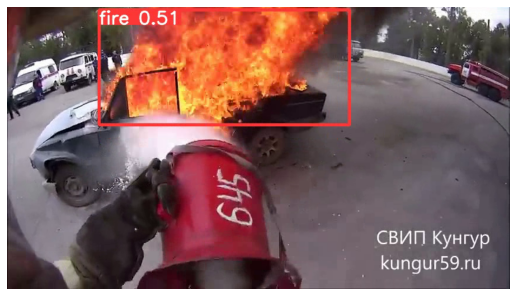

In [26]:
from matplotlib import animation, rc
import matplotlib.pyplot as plt

rc('animation', html='jshtml')

def create_animation(ims):
    fig = plt.figure(figsize=(9, 9))
    plt.axis('off')
    im = plt.imshow(ims[0])

    def animate_func(i):
        im.set_array(ims[i])
        return [im]

    return animation.FuncAnimation(fig, animate_func, frames = len(ims), interval = 1000//12)

create_animation(images)